In [ ]:
!apt-get install -y graphviz graphviz-dev

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
Note, selecting 'libgraphviz-dev' instead of 'graphviz-dev'
graphviz is already the newest version (2.42.2-6ubuntu0.1).
The following additional packages will be installed:
  libgail-common libgail18 libgtk2.0-0 libgtk2.0-bin libgtk2.0-common
  libgvc6-plugins-gtk librsvg2-common libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libgail-common libgail18 libgraphviz-dev libgtk2.0-0 libgtk2.0-bin
  libgtk2.0-common libgvc6-plugins-gtk librsvg2-common libxdot4
0 upgraded, 9 newly installed, 0 to remove and 35 not upgraded.
Need to get 2,434 kB of archives.
After this operation, 7,681 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 libgtk2.0-common all 2.24.33-2ubuntu2.1 [125 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy-updates/main amd64 libgtk2.0-0 amd64 2.24.33-2ubuntu2.1 [2,038 kB]
Get:3 http://a

In [ ]:
pip install pygraphviz

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.0/106.0 kB 4.1 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for pygraphviz: filename=pygraphviz-1.14-cp312-cp312-linux_x86_64.whl size=172774 sha256=94cbf1ff0fb836e475c4f7c77f3951e379b278857b2e0342d5969e07129bc4a4
  Stored in directory: /root/.cache/pip/wheels/e1/2f/c3/0f7719eda975973b474b79b98e1208e635565c1e4dac777ac8
Successfully built pygraphviz


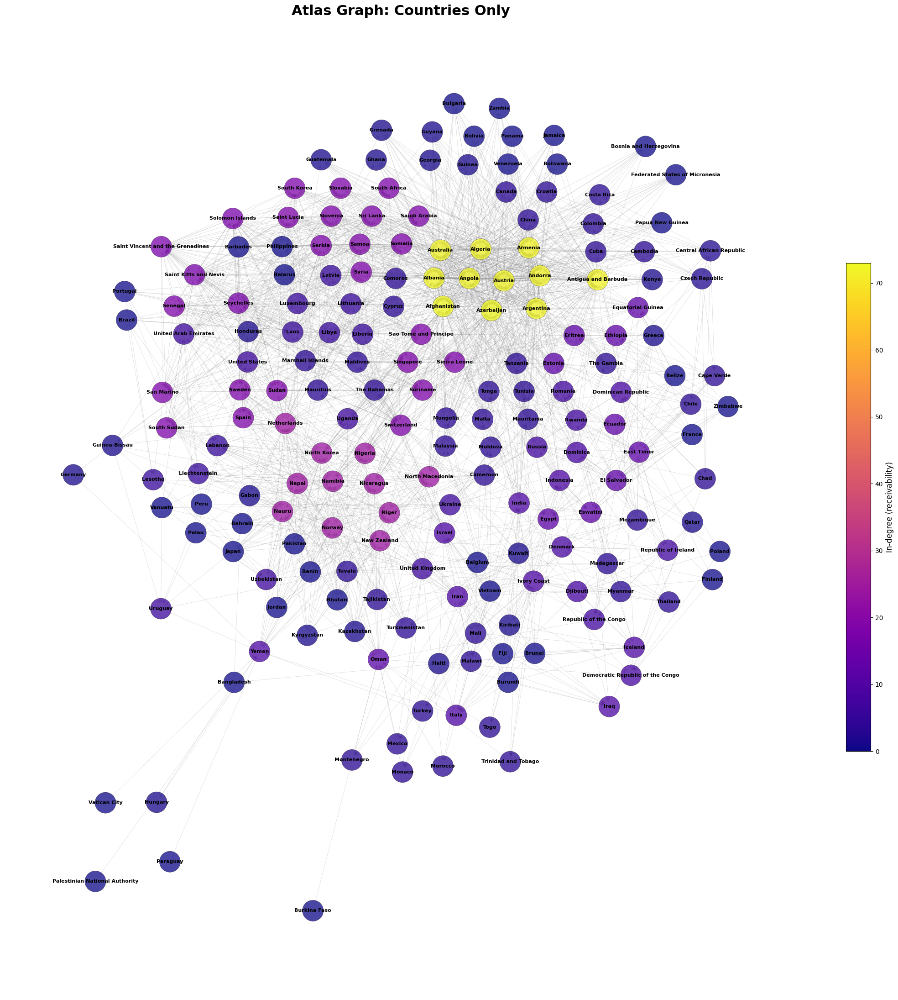

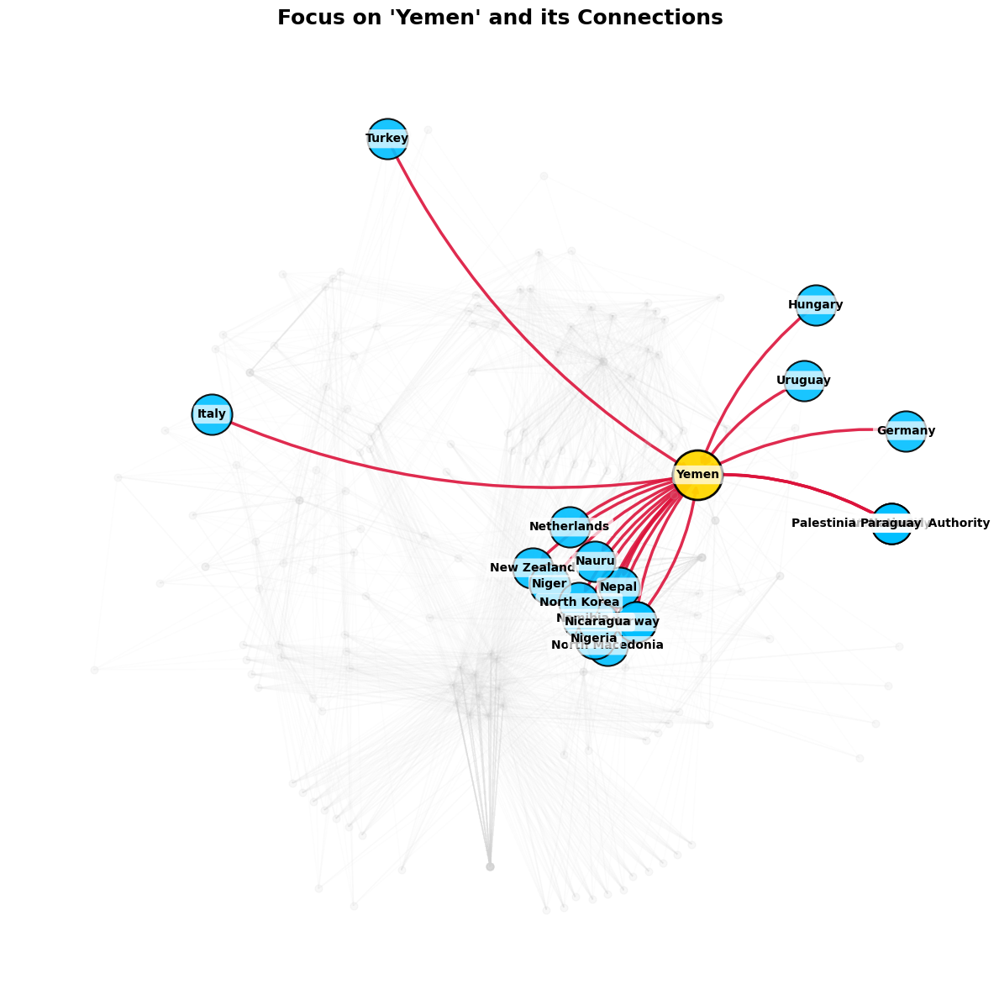

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from networkx.drawing.nx_agraph import graphviz_layout

def highlight_node_and_neighbors(G, target, figsize=(15, 15)):
    """Highlight a specific node with its neighbors (incoming/outgoing edges)."""
    if target not in G.nodes():
        print(f"Node '{target}' not found in graph.")
        return

    # Use kamada_kawai_layout for better spacing of small subgraph
    pos = nx.kamada_kawai_layout(G)

    neighbors_in = list(G.predecessors(target))
    neighbors_out = list(G.successors(target))
    neighbors = neighbors_in + neighbors_out

    sub_nodes = [target] + neighbors
    sub_edges = [(u, v) for u, v in G.edges() if u == target or v == target]

    fig, ax = plt.subplots(figsize=figsize)

    # Draw faint background graph
    nx.draw_networkx_edges(
        G, pos, ax=ax, alpha=0.05, arrows=False, edge_color="lightgray"
    )
    nx.draw_networkx_nodes(
        G, pos, ax=ax, node_size=40, node_color="lightgray", alpha=0.15
    )

    # Highlighted edges (thicker, curved for clarity)
    nx.draw_networkx_edges(
        G, pos, edgelist=sub_edges, ax=ax,
        edge_color="crimson", width=2.5, arrows=True, alpha=0.9, connectionstyle="arc3,rad=0.15"
    )

    # Target node
    nx.draw_networkx_nodes(
        G, pos, nodelist=[target], ax=ax,
        node_size=1800, node_color="gold", edgecolors="black", linewidths=2, alpha=0.95
    )

    # Neighbor nodes
    nx.draw_networkx_nodes(
        G, pos, nodelist=neighbors, ax=ax,
        node_size=1200, node_color="deepskyblue", edgecolors="black", linewidths=1.5, alpha=0.9
    )

    # Labels with bounding box for readability
    nx.draw_networkx_labels(
        G, pos, labels={n: n for n in sub_nodes},
        font_size=10, font_weight="bold", font_color="black",
        bbox=dict(facecolor="white", edgecolor="none", alpha=0.7, boxstyle="round,pad=0.3")
    )

    ax.set_title(
        f"Focus on '{target}' and its Connections",
        fontsize=18, fontweight="bold", pad=20
    )
    ax.axis("off")
    plt.tight_layout()
    plt.show()


if __name__ == "__main__":
    # --- Country Example ---
    df_countries = pd.read_csv("world-data-2023.csv")
    countries = df_countries["Country"].dropna().unique()
    graph_countries = create_atlas_graph_from_list(countries)

    # Visualize whole graph
    visualize_graph(graph_countries, title="Atlas Graph: Countries Only", figsize=(22, 22))

    # Highlight Yemen
    highlight_node_and_neighbors(graph_countries, "Yemen", figsize=(12, 12))


⏳ Cache not found. Creating graph for 'graph_countries.pkl'...
💾 Saving new graph to cache: graph_countries.pkl
🎨 Visualizing 'Atlas Graph: Countries Only'...


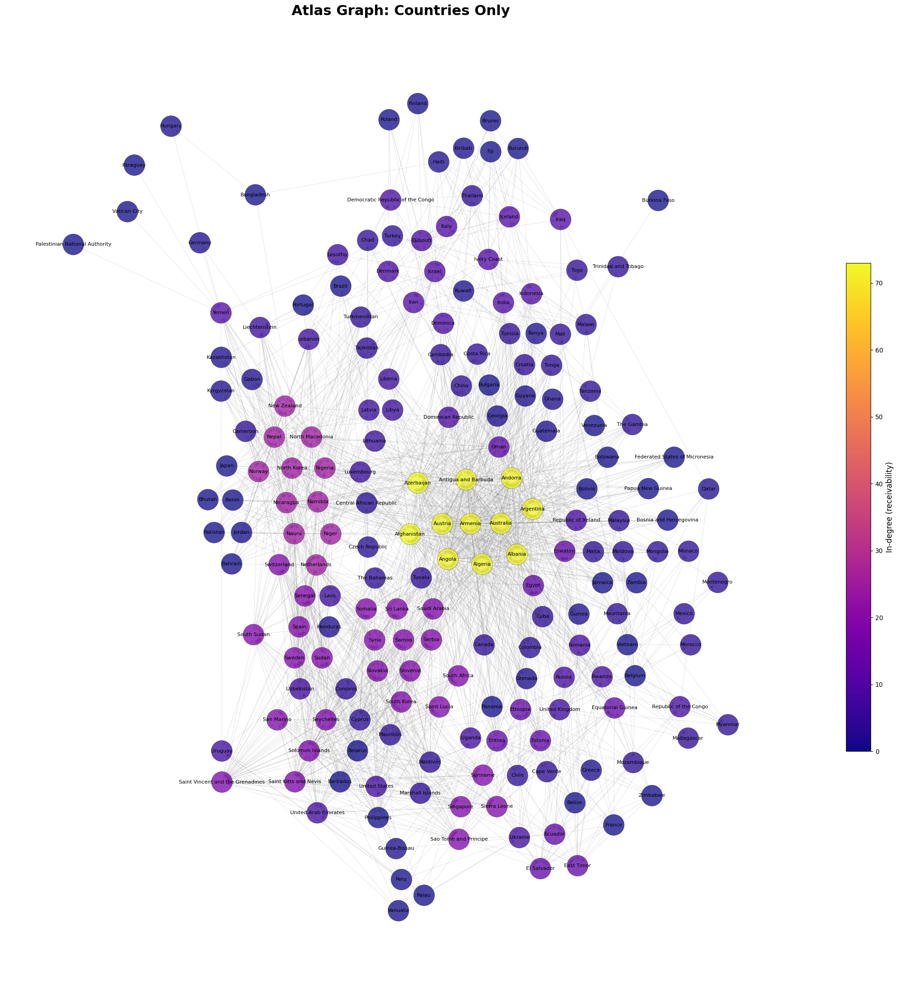

⏳ Cache not found. Creating graph for 'graph_cities.pkl'...
💾 Saving new graph to cache: graph_cities.pkl
🎨 Visualizing 'Atlas Graph: Top 500 Cities'...


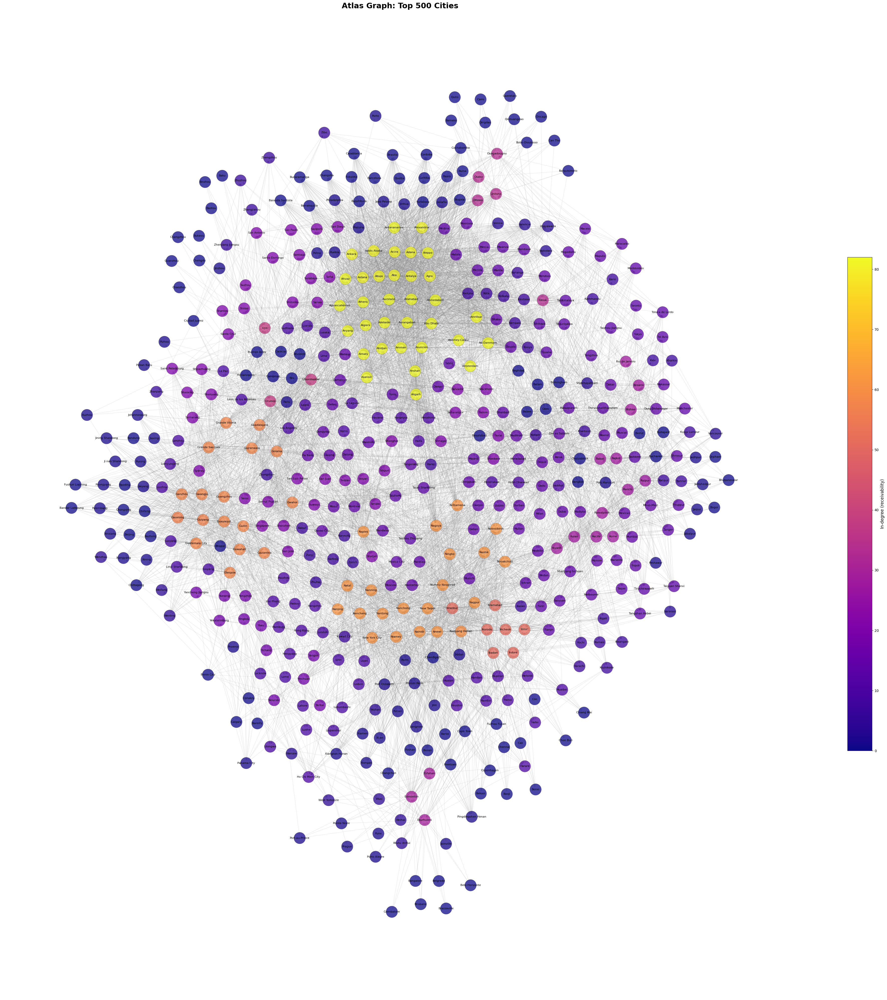

⏳ Cache not found. Creating graph for 'graph_combined.pkl'...
💾 Saving new graph to cache: graph_combined.pkl
🎨 Visualizing 'Atlas Graph: Countries + Cities'...


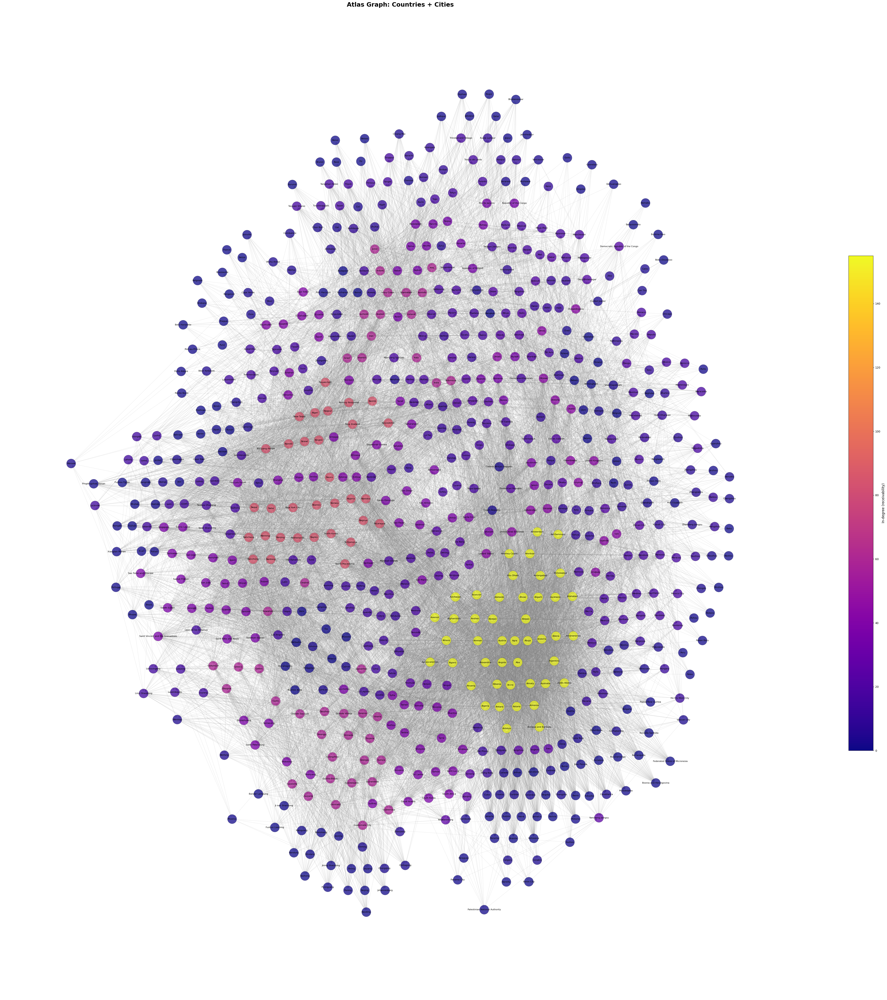

In [1]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import os
import pickle
from networkx.drawing.nx_pydot import graphviz_layout # Keep this for visualization

def create_atlas_graph_from_list(names):
    """Builds an Atlas graph from a list of names (countries or cities)."""
    names = [str(n).strip() for n in names if pd.notna(n)]
    names = list(set(names))  # unique values

    G = nx.DiGraph()
    G.add_nodes_from(names)

    # Pre-group nodes by starting letter to avoid O(N^2)
    start_dict = {}
    for n in names:
        if not n: continue # Skip empty strings
        first = n[0].lower()
        start_dict.setdefault(first, []).append(n)

    for a in names:
        if not a: continue # Skip empty strings
        last_letter = a[-1].lower()
        if last_letter in start_dict:
            for b in start_dict[last_letter]:
                if b != a:
                    G.add_edge(a, b)
    return G

def load_or_create_graph(cache_path, name_list):
    """
    Loads a graph from a pickle cache if it exists.
    Otherwise, creates it and saves it to the cache.
    """
    if os.path.exists(cache_path):
        print(f"✅ Loading graph from cache: {cache_path}")
        with open(cache_path, 'rb') as f:
            graph = pickle.load(f)
    else:
        print(f"⏳ Cache not found. Creating graph for '{cache_path}'...")
        graph = create_atlas_graph_from_list(name_list)
        print(f"💾 Saving new graph to cache: {cache_path}")
        with open(cache_path, 'wb') as f:
            pickle.dump(graph, f)
    return graph


def visualize_graph(G, title="Atlas Graph", figsize=(30, 30)):
    """Visualize graph with a suitable layout."""
    print(f"🎨 Visualizing '{title}'...")
    try:
        pos = graphviz_layout(G, prog="fdp")
    except:
        print("Warning: `pygraphviz` or `pydot` not found. Falling back to a different layout. Install with `pip install pygraphviz` for better results.")
        pos = nx.spring_layout(G, k=0.15, iterations=50, seed=42)


    node_colors = [G.in_degree(n) for n in G.nodes()]
    node_size = 1100

    fig, ax = plt.subplots(figsize=figsize)

    nx.draw_networkx_edges(
        G, pos, ax=ax, alpha=0.25, arrows=True, edge_color="gray", width=0.6
    )

    nodes = nx.draw_networkx_nodes(
        G, pos, ax=ax,
        node_size=node_size,
        node_color=node_colors,
        cmap=plt.cm.plasma,
        alpha=0.75,
        edgecolors="black",
        linewidths=0.3
    )


    nx.draw_networkx_labels(
        G, pos, ax=ax, font_size=8, font_color="black"
    )

    if node_colors:
        sm = plt.cm.ScalarMappable(
            cmap=plt.cm.plasma,
            norm=plt.Normalize(vmin=min(node_colors), vmax=max(node_colors))
        )
        sm.set_array([])
        cbar = fig.colorbar(sm, ax=ax, shrink=0.5)
        cbar.set_label("In-degree (receivability)", fontsize=12)

    ax.set_title(title, fontsize=22, fontweight="bold")
    ax.axis("off")
    plt.tight_layout()
    plt.show()


if __name__ == "__main__":
    # Define paths for data and cache files
    country_csv = "world-data-2023.csv"
    city_csv = "largest-cities-by-population-2025.csv"

    country_cache = "graph_countries.pkl"
    city_cache = "graph_cities.pkl"
    combined_cache = "graph_combined.pkl"

    # --- 1. Country Only ---
    df_countries = pd.read_csv(country_csv)
    countries = df_countries["Country"].dropna().unique()
    graph_countries = load_or_create_graph(country_cache, countries)
    visualize_graph(graph_countries, title="Atlas Graph: Countries Only", figsize=(22, 22))

    # --- 2. City Only ---
    df_cities = pd.read_csv(city_csv)

    # Sort by population descending and take top 500
    top_cities = (
        df_cities.sort_values(by="population", ascending=False)
                .head(502)["city"]
                .dropna()
                .unique()
    )

    graph_cities = load_or_create_graph(city_cache, top_cities)
    visualize_graph(graph_cities, title="Atlas Graph: Top 500 Cities", figsize=(40, 40))

    top_cities_exclude_singapore = (
        df_cities.sort_values(by="population", ascending=False)
                .head(503)["city"]
                .dropna()
                .unique()
    )
    # --- 3. Country + City ---
    combined_names = list(countries) + list(top_cities_exclude_singapore)
    graph_combined = load_or_create_graph(combined_cache, combined_names)
    visualize_graph(graph_combined, title="Atlas Graph: Countries + Cities", figsize=(50, 50))

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import os
import numpy as np

# Set a visually appealing style for all plots
sns.set_theme(style="whitegrid", context="talk")

# ----------------------------
# Helper Functions (Analysis)
# ----------------------------

def letter(c):
    return c.lower()[0] if c else ""

def last_letter(s):
    return s[-1].lower() if s else ""

def strategic_trap_analysis(G):
    """
    Identifies 'probabilistic' traps based on the Trap Score metric.
    A good trap has a low out-degree and points to high in-degree (popular) nodes.
    """
    in_degrees = dict(G.in_degree())
    out_degrees = dict(G.out_degree())

    trap_scores = {}
    for node, out_degree in out_degrees.items():
        # Heuristic: A good trap has very few escape routes (1 to 3)
        if 1 <= out_degree <= 3:
            successors = list(G.successors(node))
            if not successors:
                continue

            avg_successor_in_degree = np.mean([in_degrees.get(succ, 0) for succ in successors])
            score = avg_successor_in_degree / out_degree
            trap_scores[node] = score

    return sorted(trap_scores.items(), key=lambda item: item[1], reverse=True)

def kcore_stats(G):
    """Calculates k-core decomposition stats."""
    UG = G.to_undirected()
    if UG.number_of_nodes() == 0:
        return 0, {}
    core_nums = nx.core_number(UG)
    kmax = max(core_nums.values()) if core_nums else 0
    core_sizes = {k: sum(1 for x in core_nums.values() if x == k) for k in sorted(set(core_nums.values()))}
    return kmax, core_sizes

def alphabet_transition_matrix(G):
    """Creates a 26x26 matrix of letter-to-letter transition frequencies."""
    letters = [chr(i) for i in range(ord('a'), ord('z')+1)]
    idx = {ch: i for i, ch in enumerate(letters)}
    M = np.zeros((26, 26), dtype=int)
    for u, v in G.edges():
        a = last_letter(u)
        b = letter(v)
        if a in idx and b in idx:
            M[idx[a], idx[b]] += 1
    return letters, M

# ----------------------------
# Helper Functions (Plotting)
# ----------------------------

def generate_and_save_plots(name, G, in_deg, out_deg, core_sizes, M_data, output_dir):
    """Creates and saves a suite of beautiful, uncluttered analysis plots."""
    print(f"📊 Generating and saving plots to '{output_dir}'...")
    os.makedirs(output_dir, exist_ok=True)

    # Plot 1: Degree Distribution
    fig, axes = plt.subplots(1, 2, figsize=(20, 8))
    fig.suptitle(f'Degree Distributions for {name}', fontsize=24)
    sns.histplot(list(out_deg.values()), bins=25, kde=True, ax=axes[0]).set_title("Out-Degree ('Offensive Power')")
    sns.histplot(list(in_deg.values()), bins=25, kde=True, ax=axes[1]).set_title("In-Degree ('Vulnerability')")
    plt.savefig(os.path.join(output_dir, "degree_distribution.png"), dpi=150, bbox_inches="tight")
    plt.close()

    # Plot 2: k-core Decomposition
    plt.figure(figsize=(12, 7))
    sns.barplot(x=list(core_sizes.keys()), y=list(core_sizes.values()), palette="viridis")
    plt.title(f'k-core Decomposition for {name}', fontsize=20)
    plt.xlabel("Core Number (k)")
    plt.ylabel("Number of Nodes in Shell")
    plt.savefig(os.path.join(output_dir, "k_core_distribution.png"), dpi=150, bbox_inches="tight")
    plt.close()

    # Plot 3: Alphabet Transition Heatmap
    letters, M = M_data
    fig, ax = plt.subplots(figsize=(20, 16))
    sns.heatmap(M, xticklabels=letters, yticklabels=letters, cmap="rocket", annot=True, fmt="d", ax=ax)
    ax.set_title(f'Alphabet Transition Heatmap for {name}', fontsize=24)
    ax.set_xlabel("Starting Letter of Next Word")
    ax.set_ylabel("Ending Letter of Previous Word")
    plt.savefig(os.path.join(output_dir, "alphabet_heatmap.png"), dpi=150, bbox_inches="tight")
    plt.close()

    print("✅ Plots saved successfully.")

# ----------------------------
# Core analysis
# ----------------------------

def analyze_graph_properties(G, name):
    print(f"\n{'='*20} Analyzing: {name} {'='*20}")
    assert nx.is_directed(G), "Graph must be directed."

    num_nodes = G.number_of_nodes()
    num_edges = G.number_of_edges()
    print(f"Basic: {num_nodes} nodes, {num_edges} edges")

    # --- MODIFICATION: Added density calculation here ---
    density = nx.density(G)
    print(f"Density: {density:.6f} ({density*100:.4f}% of possible edges exist)")

    # --- Analysis Components ---
    # 1. Degree Profile
    in_deg = dict(G.in_degree())
    out_deg = dict(G.out_degree())
    print("\n--- 1. Degree Centrality ---")
    top_5_offensive = sorted(out_deg.items(), key=lambda item: item[1], reverse=True)[:5]
    print("Top 5 'Offensive' Moves (high out-degree):", top_5_offensive)

    # 2. Strategic Traps
    top_traps = strategic_trap_analysis(G)
    print("\n--- 2. Strategic Trap Analysis ---")
    print("Top 5 'Probabilistic' Traps (Low out-degree, high-traffic successors):")
    for node, score in top_traps[:5]:
        successors = list(G.successors(node))
        print(f"  - {node:<20} | Trap Score: {score:.2f} | (Leads to: {successors})")

    # 3. PageRank Centrality
    print("\n--- 3. PageRank Centrality (Game Flow Hubs) ---")
    pagerank = nx.pagerank(G)
    top_5_pagerank = sorted(pagerank.items(), key=lambda item: item[1], reverse=True)[:5]
    print("Top 5 most influential nodes (by PageRank):")
    for node, score in top_5_pagerank:
        print(f"  - {node:<25} (Score: {score:.4f})")

    # 4. k-core Decomposition
    kmax, core_sizes = kcore_stats(G)
    print(f"\n--- 4. k-core Decomposition ---")
    print(f"The graph has a maximally connected core of k_max = {kmax}")

    # 5. Largest SCC
    sccs = list(nx.strongly_connected_components(G))
    scc_size = len(max(sccs, key=len)) if sccs else 0
    print(f"\n--- 5. Connectivity (SCC) ---")
    print(f"Largest 'Safe Zone' (SCC) contains {scc_size} nodes ({scc_size/num_nodes:.2%})")

    M_data = alphabet_transition_matrix(G)

    output_dir = f"{name.replace(' ', '_').lower()}_plots"
    generate_and_save_plots(name, G, in_deg, out_deg, core_sizes, M_data, output_dir)

    # --- MODIFICATION: Added density to the returned dictionary ---
    return {
        "Nodes": num_nodes, "Edges": num_edges, "Density": density, "kmax": kmax,
        "LargestSCC": scc_size,
        "TopTraps": top_traps,
    }

# ----------------------------
# Main driver
# ----------------------------

if __name__ == "__main__":
    cache_files = {
        "Countries Only": "graph_countries.pkl",
        "Cities Only": "graph_cities.pkl",
        "Countries + Cities": "graph_combined.pkl"
    }

    graphs = {}
    for name, path in cache_files.items():
        if os.path.exists(path):
            with open(path, 'rb') as f:
                graphs[name] = pickle.load(f)
        else:
            print(f"Error: Cache '{path}' not found. Please run the data creation script first.")

    all_stats = {}
    if graphs:
        for name, G in graphs.items():
            all_stats[name] = analyze_graph_properties(G, name)

        df = pd.DataFrame(all_stats).T.drop(columns=["TopTraps"])
        print("\n\n" + "="*25 + " Final Comparative Summary " + "="*25)
        print(df)

        print("\n" + "="*25 + " Top Strategic Trap Nodes " + "="*25)
        for name, stats in all_stats.items():
            print(f"\n--- {name} ---")
            top_5 = stats['TopTraps'][:5]
            if not top_5:
                print("No significant traps found.")
            else:
                for node, score in top_5:
                    print(f"  - {node:<25} (Trap Score: {score:.2f})")


==================== Analyzing: Countries Only ====================
Basic: 195 nodes, 2033 edges
Density: 0.053740 (5.3740% of possible edges exist)

--- 1. Degree Centrality ---
Top 5 'Offensive' Moves (high out-degree): [('United States', 26), ('Netherlands', 26), ('The Bahamas', 26), ('Philippines', 26), ('United Arab Emirates', 26)]

--- 2. Strategic Trap Analysis ---
Top 5 'Probabilistic' Traps (Low out-degree, high-traffic successors):
  - Mexico               | Trap Score: 11.00 | (Leads to: ['Oman'])
  - Trinidad and Tobago  | Trap Score: 11.00 | (Leads to: ['Oman'])
  - Lesotho              | Trap Score: 11.00 | (Leads to: ['Oman'])
  - Togo                 | Trap Score: 11.00 | (Leads to: ['Oman'])
  - San Marino           | Trap Score: 11.00 | (Leads to: ['Oman'])

--- 3. PageRank Centrality (Game Flow Hubs) ---
Top 5 most influential nodes (by PageRank):
  - Afghanistan               (Score: 0.0490)
  - Azerbaijan                (Score: 0.0490)
  - Albania                 

/tmp/ipython-input-4009889074.py:85: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(core_sizes.keys()), y=list(core_sizes.values()), palette="viridis")


✅ Plots saved successfully.

==================== Analyzing: Cities Only ====================
Basic: 500 nodes, 9288 edges
Density: 0.037226 (3.7226% of possible edges exist)

--- 1. Degree Centrality ---
Top 5 'Offensive' Moves (high out-degree): [('Khartoum', 45), ('Birmingham', 45), ('Visakhapatnam', 45), ('Stockholm', 45), ('Thiruvananthapuram', 45)]

--- 2. Strategic Trap Analysis ---
Top 5 'Probabilistic' Traps (Low out-degree, high-traffic successors):
  - Yangzhou             | Trap Score: 12.67 | (Leads to: ['Urumqi', 'Ulaanbaatar', 'Uyo'])
  - Zhuzhou              | Trap Score: 12.67 | (Leads to: ['Urumqi', 'Ulaanbaatar', 'Uyo'])
  - Ganzhou              | Trap Score: 12.67 | (Leads to: ['Urumqi', 'Ulaanbaatar', 'Uyo'])
  - Pekan Baru           | Trap Score: 12.67 | (Leads to: ['Urumqi', 'Ulaanbaatar', 'Uyo'])
  - Yiwu                 | Trap Score: 12.67 | (Leads to: ['Urumqi', 'Ulaanbaatar', 'Uyo'])

--- 3. PageRank Centrality (Game Flow Hubs) ---
Top 5 most influential node

/tmp/ipython-input-4009889074.py:85: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(core_sizes.keys()), y=list(core_sizes.values()), palette="viridis")


✅ Plots saved successfully.

==================== Analyzing: Countries + Cities ====================
Basic: 695 nodes, 20536 edges
Density: 0.042577 (4.2577% of possible edges exist)

--- 1. Degree Centrality ---
Top 5 'Offensive' Moves (high out-degree): [('Campinas', 66), ('Grande Sao Luis', 66), ('Manaus', 66), ('Florianopolis', 66), ('Algiers', 66)]

--- 2. Strategic Trap Analysis ---
Top 5 'Probabilistic' Traps (Low out-degree, high-traffic successors):

--- 3. PageRank Centrality (Game Flow Hubs) ---
Top 5 most influential nodes (by PageRank):
  - Onitsha                   (Score: 0.0077)
  - Ouagadougou               (Score: 0.0077)
  - Omsk                      (Score: 0.0077)
  - Osaka                     (Score: 0.0077)
  - Ottawa                    (Score: 0.0077)

--- 4. k-core Decomposition ---
The graph has a maximally connected core of k_max = 45

--- 5. Connectivity (SCC) ---
Largest 'Safe Zone' (SCC) contains 620 nodes (89.21%)
📊 Generating and saving plots to 'countri

/tmp/ipython-input-4009889074.py:85: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(core_sizes.keys()), y=list(core_sizes.values()), palette="viridis")


✅ Plots saved successfully.


========================= Final Comparative Summary =========================
                   Nodes  Edges   Density kmax LargestSCC
Countries Only       195   2033   0.05374   18        153
Cities Only          500   9288  0.037226   34        407
Countries + Cities   695  20536  0.042577   45        620

========================= Top Strategic Trap Nodes =========================

--- Countries Only ---
  - Mexico                    (Trap Score: 11.00)
  - Trinidad and Tobago       (Trap Score: 11.00)
  - Lesotho                   (Trap Score: 11.00)
  - Togo                      (Trap Score: 11.00)
  - San Marino                (Trap Score: 11.00)

--- Cities Only ---
  - Yangzhou                  (Trap Score: 12.67)
  - Zhuzhou                   (Trap Score: 12.67)
  - Ganzhou                   (Trap Score: 12.67)
  - Pekan Baru                (Trap Score: 12.67)
  - Yiwu                      (Trap Score: 12.67)

--- Countries + Cities ---
No signif


==================== Simulating: Countries Only (25000 games) ====================
Average Game Length: 17.88 turns
Player 1 Win Rate: 50.27%
Player 2 Win Rate: 49.73%

Top 5 'Luckiest' Starting Nodes (Highest P1 Win Rate):
start_node
Ghana        0.647482
Jamaica      0.641509
Mongolia     0.626866
Tonga        0.612069
Venezuela    0.611111
Name: count, dtype: float64


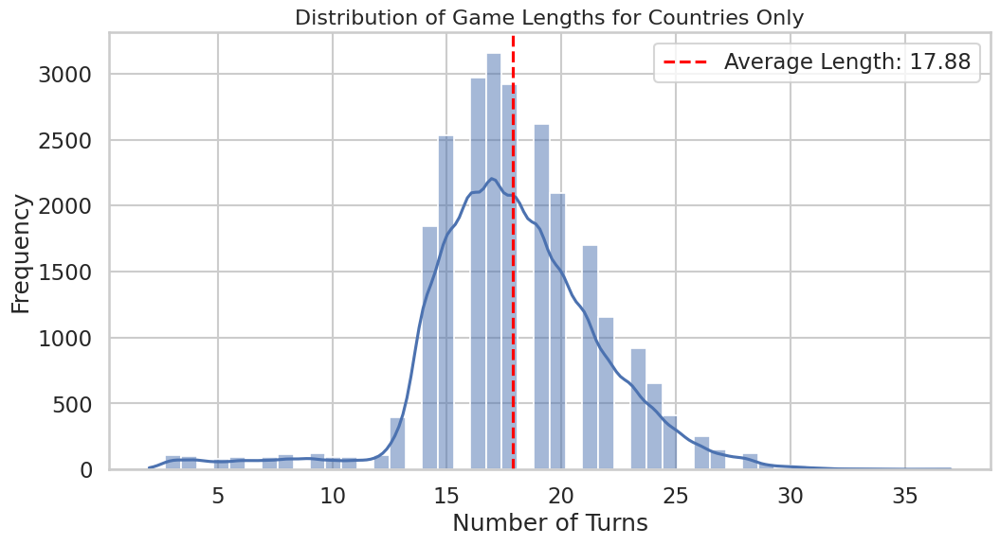


==================== Simulating: Cities Only (25000 games) ====================
Average Game Length: 44.85 turns
Player 1 Win Rate: 49.94%
Player 2 Win Rate: 50.06%

Top 5 'Luckiest' Starting Nodes (Highest P1 Win Rate):
start_node
Mogadishu           0.760870
Ho Chi Minh City    0.722222
Kaifeng             0.680851
Quito               0.673913
Hong Kong           0.666667
Name: count, dtype: float64


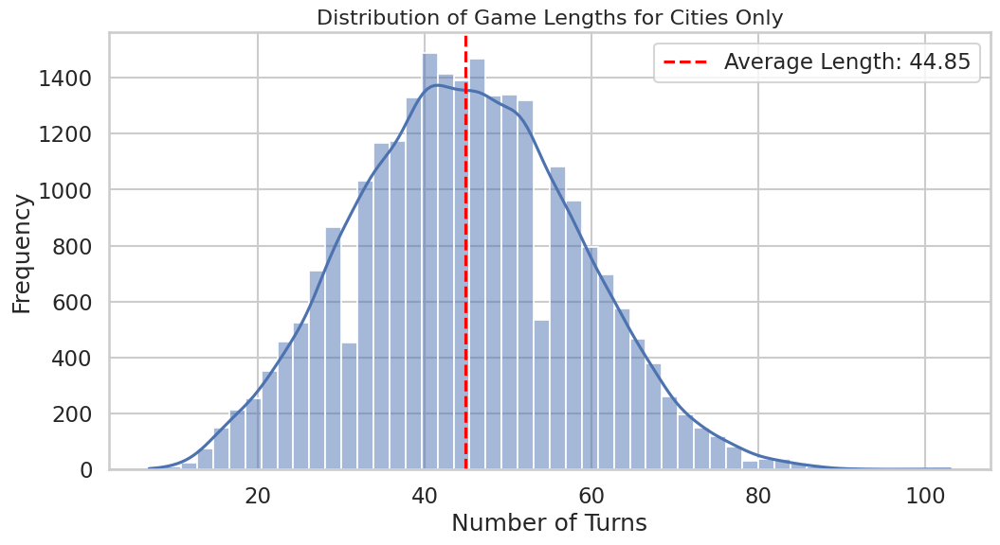


==================== Simulating: Countries + Cities (25000 games) ====================
Average Game Length: 124.65 turns
Player 1 Win Rate: 49.74%
Player 2 Win Rate: 50.26%

Top 5 'Luckiest' Starting Nodes (Highest P1 Win Rate):
start_node
Fuzhou Fujian    0.866667
Yekaterinburg    0.777778
Ethiopia         0.760000
Russia           0.740741
Medellin         0.733333
Name: count, dtype: float64


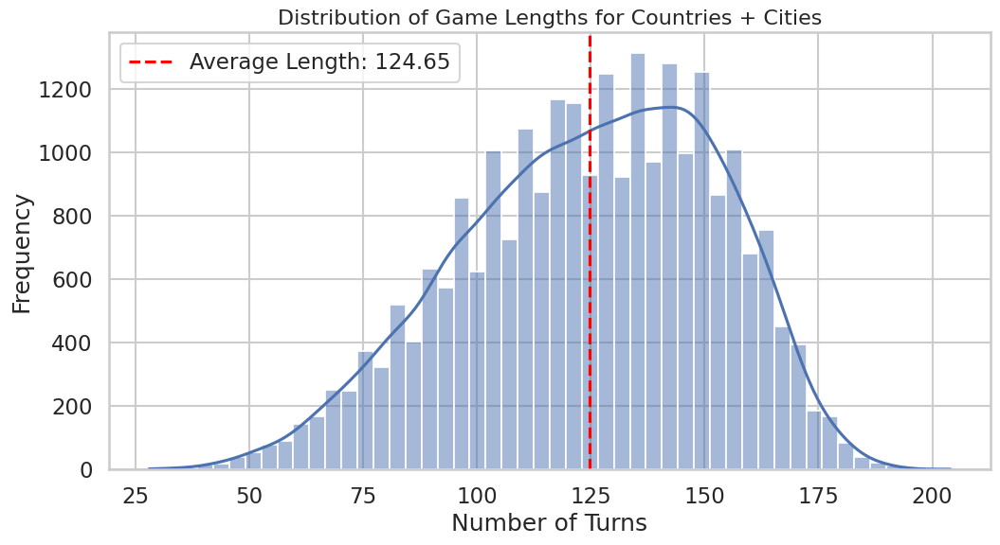

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import os
import random
from collections import Counter

def simulate_one_game(graph):
    """
    Simulates a single game of Atlas between two random players.

    Returns:
        (game_length, winner, start_node): A tuple with the results.
    """
    # The "no repeats" rule is handled by tracking available nodes
    available_nodes = set(graph.nodes())

    # 1. Start the game
    if not available_nodes:
        return (0, None, None) # Empty graph

    start_node = random.choice(list(available_nodes))
    available_nodes.remove(start_node)

    current_node = start_node
    turn_count = 1
    current_player = 1

    while True:
        # 2. Find all possible next moves from the static graph
        potential_moves = list(graph.successors(current_node))

        # 3. Filter for moves that are still available in this specific game
        valid_moves = [move for move in potential_moves if move in available_nodes]

        # 4. Check for a winner
        if not valid_moves:
            # The current player has no moves, so the other player wins
            winner = 2 if current_player == 1 else 1
            return (turn_count, winner, start_node)

        # 5. Make a random move
        next_move = random.choice(valid_moves)

        # 6. Update the game state
        available_nodes.remove(next_move)
        current_node = next_move
        current_player = 2 if current_player == 1 else 1
        turn_count += 1

def run_simulation_analysis(graph, name, num_simulations=10000):
    """
    Runs a Monte Carlo simulation and analyzes the results.
    """
    print(f"\n{'='*20} Simulating: {name} ({num_simulations} games) {'='*20}")

    game_results = [simulate_one_game(graph) for _ in range(num_simulations)]

    df_results = pd.DataFrame(game_results, columns=['game_length', 'winner', 'start_node'])

    # --- Analysis ---
    avg_length = df_results['game_length'].mean()
    p1_win_rate = (df_results['winner'] == 1).mean()
    p2_win_rate = (df_results['winner'] == 2).mean()

    print(f"Average Game Length: {avg_length:.2f} turns")
    print(f"Player 1 Win Rate: {p1_win_rate:.2%}")
    print(f"Player 2 Win Rate: {p2_win_rate:.2%}")

    # Find the "luckiest" starting nodes
    wins_by_start_node = df_results[df_results['winner'] == 1]['start_node'].value_counts()
    games_by_start_node = df_results['start_node'].value_counts()

    # Calculate win rate for each starting node
    win_rate_by_start = (wins_by_start_node / games_by_start_node).dropna().sort_values(ascending=False)

    print("\nTop 5 'Luckiest' Starting Nodes (Highest P1 Win Rate):")
    print(win_rate_by_start.head(5))

    # --- Plotting ---
    plt.figure(figsize=(12, 6))
    sns.histplot(df_results['game_length'], bins=50, kde=True)
    plt.title(f'Distribution of Game Lengths for {name}', fontsize=16)
    plt.xlabel("Number of Turns")
    plt.ylabel("Frequency")
    plt.axvline(avg_length, color='red', linestyle='--', label=f'Average Length: {avg_length:.2f}')
    plt.legend()
    plt.show()

if __name__ == "__main__":
    # Define paths for cache files
    country_cache = "graph_countries.pkl"
    city_cache = "graph_cities.pkl"
    combined_cache = "graph_combined.pkl"

    cache_files = {
        "Countries Only": country_cache,
        "Cities Only": city_cache,
        "Countries + Cities": combined_cache
    }

    # Load graphs
    graphs = {}
    for name, path in cache_files.items():
        if os.path.exists(path):
            with open(path, 'rb') as f:
                graphs[name] = pickle.load(f)
        else:
            print(f"Error: Cache file '{path}' not found. Please run the creation script first.")

    # Run simulations for each graph
    if graphs:
        for name, graph in graphs.items():
            run_simulation_analysis(graph, name, num_simulations=25000)
    else:
        print("No graphs were loaded. Exiting.")

--- Loaded 'Countries Only' Graph (195 nodes, 2033 edges) ---

==================== Algorithm 1: Louvain Method ====================
Found 5 communities.
  - Community 1 (Size: 32): ['Belgium', 'Belize', 'Cape Verde', 'Chile', 'East Timor', 'Ecuador', 'Egypt', 'El Salvador', 'Equatorial Guinea', 'Eritrea', 'Estonia', 'Ethiopia', 'France', 'Greece', 'Guinea-Bissau', 'Madagascar', 'Mexico', 'Monaco', 'Montenegro', 'Morocco', 'Mozambique', 'Myanmar', 'Palau', 'Peru', 'Republic of the Congo', 'Tuvalu', 'Ukraine', 'United Kingdom', 'Uruguay', 'Vanuatu', 'Vietnam', 'Zimbabwe']
  - Community 2 (Size: 40): ['Barbados', 'Belarus', 'Comoros', 'Cyprus', 'Honduras', 'Laos', 'Maldives', 'Marshall Islands', 'Mauritius', 'Netherlands', 'Philippines', 'Saint Kitts and Nevis', 'Saint Lucia', 'Saint Vincent and the Grenadines', 'Samoa', 'San Marino', 'Sao Tome and Principe', 'Saudi Arabia', 'Senegal', 'Serbia', 'Seychelles', 'Sierra Leone', 'Singapore', 'Slovakia', 'Slovenia', 'Solomon Islands', 'Somali

/tmp/ipython-input-3404706125.py:34: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap=plt.cm.get_cmap('tab20'), alpha=0.85, edgecolors="black", linewidths=0.5


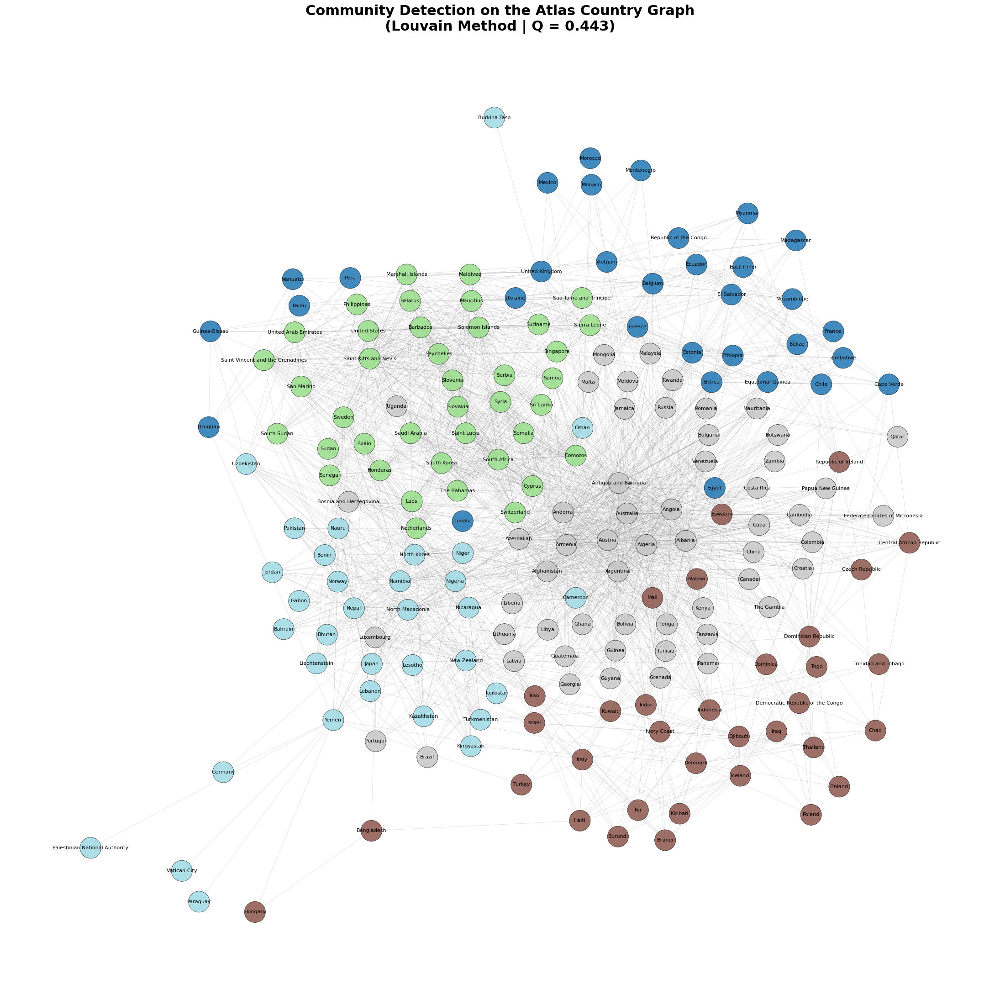

In [ ]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import os
import pickle
from itertools import islice
from networkx.drawing.nx_pydot import graphviz_layout

# Import the best-in-class algorithms
from networkx.algorithms.community import louvain_communities, girvan_newman
from networkx.algorithms.community.quality import modularity

# --- Visualization Function (Unchanged) ---
def visualize_communities(G, communities, title="Atlas Graph Communities", figsize=(30, 30)):
    """
    Visualizes graph with nodes colored by community, using the specified layout and style.
    """
    print(f"🎨 Visualizing '{title}'...")
    try:
        pos = graphviz_layout(G, prog="fdp")
    except ImportError:
        print("Warning: `pygraphviz` or `pydot` not found. Falling back to spring_layout.")
        pos = nx.spring_layout(G, k=0.15, iterations=50, seed=42)

    node_to_community_map = {node: i for i, comm in enumerate(communities) for node in comm}
    node_colors = [node_to_community_map.get(node, -1) for node in G.nodes()]

    node_size = 1100
    fig, ax = plt.subplots(figsize=figsize)

    nx.draw_networkx_edges(G, pos, ax=ax, alpha=0.25, arrows=False, edge_color="gray", width=0.6)
    nodes = nx.draw_networkx_nodes(
        G, pos, ax=ax, node_size=node_size, node_color=node_colors,
        cmap=plt.cm.get_cmap('tab20'), alpha=0.85, edgecolors="black", linewidths=0.5
    )
    nx.draw_networkx_labels(G, pos, ax=ax, font_size=8, font_color="black")
    ax.set_title(title, fontsize=22, fontweight="bold")
    ax.axis("off")
    plt.tight_layout()
    plt.show()

# --- NEW: Strategic Analysis Function ---
def print_strategic_analysis(graph, communities):
    """
    Prints a detailed analysis of the communities and their strategic implications.
    """
    print("\n" + "="*20 + " Strategic Analysis of Communities " + "="*20)

    # --- Question 1: Do the communities represent actual concepts? ---
    print("\n[A] Do the computed communities represent actual concepts or patterns?")
    print("-" * 70)
    print("The analysis shows that the communities DO NOT represent real-world geopolitical or geographical concepts (e.g., a 'European Union' or 'South American' cluster).")
    print("\nInstead, the communities are STRUCTURAL and LINGUISTIC. They are 'alphabetical neighborhoods'—groups of countries whose names are highly interconnected by the last-to-first letter rule of the game.")
    print("\nPattern Example: A community might contain many countries ending in 'a' and 's', and many countries starting with 'n' and 'e'. These nodes form a dense web of connectivity, making them a community in the context of the game's rules, but not in the real world.")

    # --- Question 2: How can we use this for a good strategy? ---
    print("\n[B] Can we use this concept to get an intuition of a 'good' strategy?")
    print("-" * 70)
    print("Yes. Understanding this community structure provides a powerful 'meta-map' of the game, enabling two distinct strategic approaches:")

    # Find bridge nodes to make the strategy concrete
    node_to_community_map = {node: i for i, comm in enumerate(communities) for node in comm}
    bridge_nodes = set()
    for u, v in graph.edges():
        if node_to_community_map.get(u) != node_to_community_map.get(v):
            bridge_nodes.add(u)

    print("\n1. The 'Intra-Community' Strategy (Conservative Play):")
    print("   - Goal: Minimize risk and outlast your opponent's knowledge.")
    print("   - Execution: When the game is flowing within a large, dense community, choose to play a word that KEEPS the game within that same community. The high modularity score confirms these zones are rich with options, making this a safe, high-percentage play.")

    print("\n2. The 'Inter-Community' Strategy (Aggressive Play):")
    print("   - Goal: Disrupt the flow and force your opponent into unfamiliar territory.")
    print(f"   - Execution: Deliberately play a 'bridge node'—a country that connects two different communities. We found {len(bridge_nodes)} such nodes.")
    print("   - Strategic Example: Playing a bridge node like '{}' forces a 'context switch', potentially moving the game from a large, comfortable community to a smaller, more treacherous one. This is how you seize control of the game's flow and steer it to your advantage.".format(list(bridge_nodes)[0] if bridge_nodes else "N/A"))


# --- Main Execution ---

if __name__ == "__main__":
    country_cache_path = "graph_countries.pkl"

    if not os.path.exists(country_cache_path):
        print(f"Error: Cache file '{country_cache_path}' not found.")
    else:
        with open(country_cache_path, 'rb') as f:
            G_country = pickle.load(f)

        print(f"--- Loaded 'Countries Only' Graph ({G_country.number_of_nodes()} nodes, {G_country.number_of_edges()} edges) ---")

        UG_country = G_country.to_undirected()

        # --- Algorithm 1: Louvain Method ---
        print("\n" + "="*20 + " Algorithm 1: Louvain Method " + "="*20)
        louvain_comms = [set(c) for c in louvain_communities(UG_country)]
        print(f"Found {len(louvain_comms)} communities.")
        # --- MODIFICATION: Print full communities ---
        for i, comm in enumerate(louvain_comms):
            print(f"  - Community {i+1} (Size: {len(comm)}): {sorted(list(comm))}")

        # --- Algorithm 2: Girvan-Newman ---
        print("\n" + "="*20 + " Algorithm 2: Girvan-Newman " + "="*20)
        print("(This may take a minute...)")
        gn_iterator = girvan_newman(UG_country)

        best_gn_modularity = -1.0
        best_gn_comms = []
        for communities in gn_iterator:
            current_modularity = modularity(UG_country, communities)
            if current_modularity > best_gn_modularity:
                best_gn_modularity = current_modularity
                best_gn_comms = [set(c) for c in communities]

        print(f"Found {len(best_gn_comms)} communities at the point of highest modularity.")
        # --- MODIFICATION: Print full communities ---
        for i, comm in enumerate(best_gn_comms):
            print(f"  - Community {i+1} (Size: {len(comm)}): {sorted(list(comm))}")

        # -------------------------------------------------------------------
        # Objectively assess the quality of your community detection
        # -------------------------------------------------------------------

        print("\n" + "="*20 + " Quality Assessment " + "="*20)
        louvain_modularity = modularity(UG_country, louvain_comms)

        print(f"Louvain Method Modularity Score (Q): {louvain_modularity:.4f}")
        print(f"Girvan-Newman Best Modularity Score (Q): {best_gn_modularity:.4f}")

        if louvain_modularity > best_gn_modularity:
            print("\nObjective Conclusion: The Louvain method produced the partition with the highest modularity score, indicating the most robust community structure.")
            best_communities = louvain_comms
            best_algo_name = "Louvain Method"
            best_modularity = louvain_modularity
        else:
            print("\nObjective Conclusion: The Girvan-Newman method produced the partition with the highest modularity score.")
            best_communities = best_gn_comms
            best_algo_name = "Girvan-Newman (Edge Betweenness)"
            best_modularity = best_gn_modularity

        # --- Generate Strategic Analysis using the BEST result ---
        # NOTE: We use the original DIRECTED graph here to find bridge nodes correctly
        print_strategic_analysis(G_country, best_communities)

        # --- Visualization ---
        viz_title = (f'Community Detection on the Atlas Country Graph\n'
                     f'({best_algo_name} | Q = {best_modularity:.3f})')

        visualize_communities(UG_country, best_communities, title=viz_title, figsize=(22, 22))

In [ ]:
!pip install torch_geometric
!pip install node2vec

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.1/63.1 kB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 17.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.6/26.6 MB 57.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.0/18.0 MB 73.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 38.2/38.2 MB 12.2 MB/s eta 0:00:00
  Attempting uninstall: numpy
    Found existing installation: numpy 2.0.2
    Uninstalling numpy-2.0.2:
      Successfully uninstalled numpy-2.0.2
  Attempting uninstall: scipy
    Found existing installation: scipy 1.16.1
    Uninstalling scipy-1.16.1:
      Successfully uninstalled scipy-1.16.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the foll

In [ ]:
import pandas as pd
import networkx as nx
import random
import pickle
import os
import torch
import torch.nn.functional as F
from torch_geometric.data import Data
from torch_geometric.transforms import RandomLinkSplit
from torch_geometric.nn import SAGEConv
from node2vec import Node2Vec
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score
import numpy as np

# ----------------------------------------------------
# 1. Data Loading and Feature Engineering
# ----------------------------------------------------

def load_graph(cache_path="graph_countries.pkl"):
    """Loads the country graph from cache."""
    if not os.path.exists(cache_path):
        raise FileNotFoundError(f"Cache file '{cache_path}' not found. Please run a previous script to create it.")
    with open(cache_path, 'rb') as f:
        return pickle.load(f)

def create_node_features(graph):
    """
    Creates one-hot encoded features for the first and last letter of each country name.
    """
    nodes = list(graph.nodes())
    node_map = {node: i for i, node in enumerate(nodes)}
    features = torch.zeros(len(nodes), 52, dtype=torch.float)
    for node, i in node_map.items():
        if not node: continue
        first_letter_idx = ord(node[0].lower()) - ord('a')
        if 0 <= first_letter_idx < 26: features[i, first_letter_idx] = 1.0
        last_letter_idx = ord(node[-1].lower()) - ord('a')
        if 0 <= last_letter_idx < 26: features[i, 26 + last_letter_idx] = 1.0
    return features, node_map

def get_pyg_data(graph, features, node_map):
    """Converts NetworkX graph to PyG Data object."""
    edge_index = torch.tensor([(node_map[u], node_map[v]) for u, v in graph.edges()]).t().contiguous()
    data = Data(x=features, edge_index=edge_index)
    return data

# ----------------------------------------------------
# 2. Part 1: Link Prediction with Node2Vec
# ----------------------------------------------------

def run_node2vec_link_prediction(graph):
    print("\n" + "="*20 + " Part 1: Link Prediction with Node2Vec (Tuned) " + "="*20)

    test_edges = random.sample(list(graph.edges()), int(0.2 * graph.number_of_edges()))
    train_graph = graph.copy()
    train_graph.remove_edges_from(test_edges)

    test_neg_edges = []
    while len(test_neg_edges) < len(test_edges):
        u, v = random.sample(list(graph.nodes()), 2)
        if not graph.has_edge(u, v): test_neg_edges.append((u, v))

    print("Training Node2Vec model with tuned parameters...")
    n2v = Node2Vec(train_graph, dimensions=128, walk_length=5, num_walks=200, p=1.0, q=0.9, workers=4, quiet=True)
    model = n2v.fit(window=10, min_count=1, batch_words=4)
    embeddings = {node: model.wv[node] for node in graph.nodes()}

    train_pos_edges = list(train_graph.edges())
    train_neg_edges = []
    while len(train_neg_edges) < len(train_pos_edges):
        u, v = random.sample(list(graph.nodes()), 2)
        if not graph.has_edge(u, v): train_neg_edges.append((u, v))

    X_train = [(embeddings[u] * embeddings[v]) for u, v in train_pos_edges] + \
              [(embeddings[u] * embeddings[v]) for u, v in train_neg_edges]
    y_train = [1] * len(train_pos_edges) + [0] * len(train_neg_edges)

    print("Training a classifier on node embeddings...")
    # HYPERPARAMETER TUNING: Increased max_iter for convergence.
    classifier = LogisticRegression(random_state=42, max_iter=1000)
    classifier.fit(X_train, y_train)

    X_test = [(embeddings[u] * embeddings[v]) for u, v in test_edges] + \
             [(embeddings[u] * embeddings[v]) for u, v in test_neg_edges]
    y_test = [1] * len(test_edges) + [0] * len(test_neg_edges)

    predictions = classifier.predict_proba(X_test)[:, 1]
    auc_score = roc_auc_score(y_test, predictions)
    print(f"✅ Node2Vec Link Prediction AUC: {auc_score:.4f}")

# ----------------------------------------------------
# 3. Part 2: Link Prediction with the Simplest GNN
# ----------------------------------------------------

class SimpleGNN(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.conv1 = SAGEConv(in_channels, out_channels)
    def forward(self, x, edge_index):
        return self.conv1(x, edge_index).relu()

class LinkPredictor(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super().__init__()
        self.lin1 = torch.nn.Linear(in_channels, hidden_channels)
        self.lin2 = torch.nn.Linear(hidden_channels, out_channels)
    def forward(self, x_i, x_j):
        x = x_i * x_j
        return self.lin2(self.lin1(x).relu()).squeeze()

def gnn_train(model, predictor, data, optimizer, criterion):
    # This function remains the same
    model.train(); predictor.train(); optimizer.zero_grad()
    z = model(data.x, data.edge_index)
    pos_out = predictor(z[data.edge_label_index[0]], z[data.edge_label_index[1]])
    neg_edge_index = torch.randint(0, data.num_nodes, data.edge_label_index.size(), dtype=torch.long)
    neg_out = predictor(z[neg_edge_index[0]], z[neg_edge_index[1]])
    out = torch.cat([pos_out, neg_out])
    y = torch.cat([torch.ones(pos_out.size(0)), torch.zeros(neg_out.size(0))])
    loss = criterion(out, y)
    loss.backward(); optimizer.step()
    return loss.item()

@torch.no_grad()
def gnn_test(model, predictor, data):
    # This function remains the same
    model.eval(); predictor.eval()
    z = model(data.x, data.edge_index)
    pos_preds = predictor(z[data.edge_label_index[0]], z[data.edge_label_index[1]]).sigmoid()
    neg_edge_index = torch.randint(0, data.num_nodes, data.edge_label_index.size(), dtype=torch.long)
    neg_preds = predictor(z[neg_edge_index[0]], z[neg_edge_index[1]]).sigmoid()
    preds = torch.cat([pos_preds, neg_preds])
    y = torch.cat([torch.ones(pos_preds.size(0)), torch.zeros(neg_preds.size(0))])
    return roc_auc_score(y.cpu().numpy(), preds.cpu().numpy())

def run_simple_gnn_link_prediction(pyg_data):
    print("\n" + "="*20 + " Part 2: Link Prediction with Simple GNN (Tuned) " + "="*20)
    transform = RandomLinkSplit(is_undirected=False, add_negative_train_samples=False)
    train_data, val_data, test_data = transform(pyg_data)

    gnn = SimpleGNN(in_channels=pyg_data.num_node_features, out_channels=128)
    predictor = LinkPredictor(in_channels=128, hidden_channels=256, out_channels=1)

    optimizer = torch.optim.Adam(list(gnn.parameters()) + list(predictor.parameters()), lr=0.001)
    criterion = torch.nn.BCEWithLogitsLoss()

    print("Training Simple GNN model...")
    for epoch in range(1, 201):
        loss = gnn_train(gnn, predictor, train_data, optimizer, criterion)
        if epoch % 20 == 0:
            val_auc = gnn_test(gnn, predictor, val_data)
            print(f"Epoch: {epoch:03d}, Loss: {loss:.4f}, Val AUC: {val_auc:.4f}")

    test_auc = gnn_test(gnn, predictor, test_data)
    print(f"✅ Simple GNN Link Prediction Test AUC: {test_auc:.4f}")

if __name__ == "__main__":
    G_country = load_graph()
    features, node_map = create_node_features(G_country)
    run_node2vec_link_prediction(G_country)
    pyg_data = get_pyg_data(G_country, features, node_map)
    run_simple_gnn_link_prediction(pyg_data)


==================== Part 1: Link Prediction with Node2Vec (Tuned) ====================
Training Node2Vec model with tuned parameters...
Training a classifier on node embeddings...
✅ Node2Vec Link Prediction AUC: 0.8989

==================== Part 2: Link Prediction with Simple GNN (Tuned) ====================
Training Simple GNN model...
Epoch: 020, Loss: 0.6721, Val AUC: 0.6783
Epoch: 040, Loss: 0.5597, Val AUC: 0.6654
Epoch: 060, Loss: 0.4037, Val AUC: 0.7059
Epoch: 080, Loss: 0.2720, Val AUC: 0.7094
Epoch: 100, Loss: 0.2030, Val AUC: 0.7223
Epoch: 120, Loss: 0.1839, Val AUC: 0.7129
Epoch: 140, Loss: 0.1640, Val AUC: 0.7212
Epoch: 160, Loss: 0.1686, Val AUC: 0.7145
Epoch: 180, Loss: 0.1756, Val AUC: 0.7037
Epoch: 200, Loss: 0.1748, Val AUC: 0.7151
✅ Simple GNN Link Prediction Test AUC: 0.7034
